In [1]:
import json
import numpy as np
import torch
from os.path import join
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import pandas as pd
import seaborn as sns
from itertools import product
from PIL import Image
import cv2
from tqdm import tqdm
import pickle



import dataset
from projectdata import naturaldesign
from tasks.visual_search import *
from Scanpath_Prediction.irl_dcb.utils import *
from torchvision import transforms
import json
import json
import json
import json
import numpy as np
import torch
from os.path import join
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
import pandas as pd
import seaborn as sns
from itertools import product
from PIL import Image
import cv2
from tqdm import tqdm
import pickle



import dataset
from projectdata import naturaldesign
from tasks.visual_search import *
from Scanpath_Prediction.irl_dcb.utils import *
from torchvision import transforms

In [2]:
print('demo')

demo


# Common parameters

In [7]:
device = 'cuda'
search_w = 1280
search_h = 1024
vit_search_w = int(1280/2)
vit_search_h = int(1024/2)
target_min = 128
patch_w = 16
patch_h = 16
n_patch_w, n_patch_h = int(vit_search_w // patch_w), int(vit_search_h // patch_h)
IOR_size = 100 
dataset = 'toy-world' 
n_random = 100

if dataset == 'toy-world':
    with open('/home/shokoofeh/mytct/src/context/CRT_toy_world.pkl', 'rb') as handle:
        crt_attn = pickle.load(handle)
        

## Load model

In [8]:
## vit fine-tuned in cifar10 with no position embedding
import torch
vit = load_model()

## Load dataset

In [9]:
dset_config = dict(dataset_dir = '/home/shokoofeh/mytct/src/toyworld/frames', search_size=(search_h, search_w), target_size=(0, 0), per_target=True, is_transform=True)

dset = naturaldesign.NaturalDesign(**dset_config)

vit_dset_config = dict(dataset_dir = '/home/shokoofeh/mytct/src/toyworld/frames', search_size=(vit_search_h, vit_search_w), target_size=(0, 0), per_target=True, is_transform=True)

vit_dset = naturaldesign.NaturalDesign(**vit_dset_config)
print(dset_config)
print(len(dset))

{'dataset_dir': '/home/shokoofeh/mytct/src/toyworld/frames', 'search_size': (1024, 1280), 'target_size': (0, 0), 'per_target': True, 'is_transform': True}
81


## Perform search tasks

# Only TCT SHK added


In [11]:
device = 'cuda'

result = dict()
print(len(dset))
for i in tqdm(range(1, len(dset)-1)):
    key = 'img{:03}.jpg'.format(i)
    result[key] = dict()
    temp = result[key]

    # Load data
    s_im, t_im = dset[i]
    #s_im, t_im, solution, t_bbox = dset.__getitem__(i)
    vit_s_im, vit_t_im = vit_dset.__getitem__(i)

    # ======== TCT MODEL (ViT + CRT global integration) ======== #
    crt_tensor = crt_attn[key]
    norm_crt_tensor = crt_tensor / crt_tensor.max()
    norm_crt_relevance = transforms.Resize((search_h, search_w))(norm_crt_tensor).cpu().squeeze().numpy() 

    # Prepare contextual tensor for modulation
    crt_tensor = transforms.Resize((n_patch_h, n_patch_w))(norm_crt_tensor).squeeze().reshape(-1).to(device)
    crt_tensor = (crt_tensor - crt_tensor.mean()) / crt_tensor.std() * 100
    crt_tensor = torch.sigmoid(crt_tensor)

    # ---- Integrated CRT global modulation ----
    flag = 'crt_global_3_'
    crt_mod_method = 5
    layer = 3 - 1  # corresponds to l = 3 in paper
    crt_global_mod_layers = [layer]
    crt_global_mod = crt_tensor
    crt_local_mod = None

    attns, paths = [], []
    for n in [6, 7]:  # late layers used for target modulation
        target_embedding = None
        mod_attn = get_attn(
            vit,
            vit_s_im,
            crt_mod_method=crt_mod_method,
            crt_global_mod_layers=crt_global_mod_layers,
            crt_global_mod=crt_global_mod,
            crt_local_mod=crt_local_mod,
            mod_last_n=n,
            t_im=vit_t_im,
            target_embedding=target_embedding,
            mod='relevance',
            processed=True
        )
        mod_attn = transforms.Resize((search_h, search_w))(torch.as_tensor(mod_attn[None])).squeeze().numpy()
        attn = add_init_fix(mod_attn, search_w, search_h)
        path = search_task(attn, inh_size=IOR_size, fix_method='relaxed')
        attns.append(mod_attn)
        paths.append(path)

    temp[f'{flag}mod_attns'] = np.stack(attns)
    temp[f'{flag}paths_rel'] = paths
    # ============================================================ #

with open('/home/shokoofeh/mytct/src/vit-visual-search/results/[toyworld_TCT_only].pkl', 'wb') as handle:
    pickle.dump(result, handle, protocol=pickle.HIGHEST_PROTOCOL)


81


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 79/79 [01:58<00:00,  1.50s/it]


## Visualize scan path

In [12]:
with open('/home/shokoofeh/mytct/src/vit-visual-search/results/[toyworld_TCT_only].pkl', 'rb') as handle:
    result = pickle.load(handle)

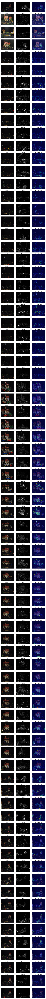

In [13]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle
from PIL import Image
import os
from torchvision import transforms

# Fix random seed and select random samples
np.random.seed(19)
idxs = np.arange(1, 80)

# Prepare figure (2 columns: search image + TCT result)
fig, axes = plt.subplots(len(idxs), 3, figsize=(8, 160))

for ax_row, i in zip(axes, idxs):
    key = f'img{i:03}.jpg'
    dic = result[key]
    

    search_im = Image.open(os.path.join(dset.search_dir, f'img{i:03}.jpg')).convert('RGB')
    search_im = np.asarray(transforms.Resize((search_h, search_w))(search_im))
    
    # Load TCT attention map and fixation path
    global_attn, global_path = dic['crt_global_3_mod_attns'][0], dic['crt_global_3_paths_rel'][0]
    
    # --- Column 1: Search image 
    ax_row[0].imshow(search_im)
    ax_row[0].set_title('Search image', fontsize=7)
    ax_row[0].axis('off')
    
    # --- Column 2: TCT (ViT + CRT global integration) attention ---
    ax_row[1].imshow(global_attn, cmap='gray')
    ax_row[1].set_title('TCT attention', fontsize=7)
    ax_row[1].axis('off')

    # --- Column 3: overlay attention on search image ---
    ax_row[2].imshow(search_im)
    ax_row[2].imshow(global_attn, cmap='jet', alpha=0.4)
    ax_row[2].set_title('TCT attention overlay', fontsize=8)
    ax_row[2].axis('off')

# Adjust layout
fig.tight_layout()
plt.show()


# SHK modified Original


In [14]:
device = 'cuda'

result = dict()
print(len(dset))
for i in tqdm(range(1, len(dset)-1)):
    key = 'img{:03}.jpg'.format(i)
    result[key] = dict()
    temp = result[key]
    s_im, t_im = dset.__getitem__(i)
    vit_s_im, vit_t_im = vit_dset.__getitem__(i)
    

    for crt in [None, 'global_3']:
        # Task 2: VIT local modulation alone
        if crt is None:
            flag = ''
            crt_mod_method = None
            crt_global_mod_layers = []
            crt_global_mod = None
            crt_local_mod = None

        # Task 3: Integrated CRT global & VIT local
        elif 'global' in crt:
            flag = 'crt_{}_'.format(crt)
            crt_mod_method = 5
            layer = eval(crt.split('_')[1])-1
            crt_global_mod_layers = [layer]
            crt_global_mod = crt_tensor
            crt_local_mod = None

        attns, paths = [], []
        for n in [6, 7]:
            target_embedding = None
            mod_attn = get_attn(vit, vit_s_im, crt_mod_method=crt_mod_method, crt_global_mod_layers=crt_global_mod_layers, crt_global_mod=crt_global_mod, crt_local_mod=crt_local_mod, mod_last_n=n, t_im=vit_t_im, target_embedding=target_embedding, mod='relevance', processed=True)
            mod_attn = transforms.Resize((search_h, search_w))(torch.as_tensor(mod_attn[None])).squeeze().numpy() 
            attn = add_init_fix(mod_attn, search_w, search_h)
            path = search_task(attn, inh_size=IOR_size, fix_method='relaxed')
            attns.append(mod_attn)
            paths.append(path)


        temp['{}mod_attns'.format(flag)] = np.stack(attns)
        temp['{}paths_rel'.format(flag)] = paths

with open('/home/shokoofeh/mytct/src/vit-visual-search/results/[toyworld_TCT_modified].pkl', 'wb') as handle:
    pickle.dump(result, handle, protocol=pickle.HIGHEST_PROTOCOL)


81


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████| 79/79 [05:00<00:00,  3.80s/it]


# SHK Visualized modified original to compare with mine

In [17]:
with open('/home/shokoofeh/mytct/src/vit-visual-search/results/[toyworld_TCT_modified].pkl', 'rb') as handle:
    result = pickle.load(handle)

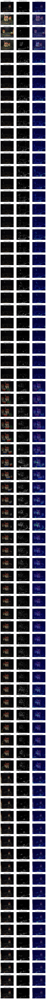

In [18]:
np.random.seed(19)

idxs = np.arange(1, 80)

fig, axes = plt.subplots(len(idxs), 3, figsize=(8, 160))
for ax, i in zip(axes, idxs):
    key = 'img{:03}.jpg'.format(i)
    dic = result[key]
    
    search_im = Image.open(os.path.join(dset.search_dir, 'img{:03}.jpg'.format(i))).convert('RGB')
    search_im = np.asarray(transforms.Resize((search_h, search_w))(search_im))


    global_attn, global_path = dic['crt_global_3_mod_attns'][0], dic['crt_global_3_paths_rel'][0]
    
    ax[0].imshow(search_im)
    ax[0].set_title('search image')

    
    ax[1].imshow(global_attn, cmap='gray')
    x = global_path[:, 0]
    y = global_path[:, 1]
    ax[1].set_title('TCTM attention')

    # --- Column 3: overlay attention on search image ---
    ax[2].imshow(search_im)
    ax[2].imshow(global_attn, cmap='jet', alpha=0.4)
    ax[2].set_title('TCT attention overlay', fontsize=8)
    ax[2].axis('off')

for axis in axes.ravel():
    axis.axis('off')
fig.tight_layout()